<a href="https://colab.research.google.com/github/themusician3242/Machine-Learning-Projects/blob/main/dogvision.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#End-to-end Multi Class Dog Breed Classification

This notebook builds ad end-to-end multiclass image classifier using TensorFlow 2.0 and TensorFlow hub.

## 1. Problem:
Identifying the breed of a dog given an image of a dog.

When I'm sitting at the cafe and I want to take photos of dogs, I want to know what breed of dog they are.

## 2. Data:
The data we're using is from Kaggle's dog breed identification competition.

## 3. Evaluation

The evaluation is a file with prediction probabiltiies for each dog breed for each test image.

## 4. Features:

Some info about the data:
- We're dealing with images (unstructured data)
- Probably best to use Deep/Transfer Learning.
- 120 breeds of dogs (this means there are 120 different classes).
- 10222 unique values. --> 10222 images!







In [1]:
#!unzip "drive/MyDrive/Colab Notebooks/Data/dog-breed-identification.zip" -d "drive/MyDrive/Colab Notebooks"

# Getting our Workspace Ready

* Import TensorFlow  2.x
* Import TensorFlow Hub
* Make Sure a GPU is Being Used!

### Getting our Data Ready (turning into Tensors):
With all ML models, our data must be in numerical format. We are turning our images into Tensors (numerical inputs).

Let's start by accessing our data and checking out the labels.


In [2]:
# Import TensorFlow into CoLab
import tensorflow as tf
import tensorflow_hub as hub
import tf_keras as keras

# Check for GPU availability:
print("GPU", "Available" if tf.config.list_physical_devices("GPU") else "Unavailable")

GPU Available


In [3]:
# Let's make sure we're using TensorFlow & Keras 2.15.0 & Hub 0.16.1 for Compatibility.

In [4]:
# pip install tensorflow==2.15.0 keras==2.15.0 tensorflow-hub==0.16.1

In [5]:
print("TF Version:", tf.__version__)
print("TF Hub Version:", hub.__version__)
print("Keras Version:", keras.__version__)

TF Version: 2.15.0
TF Hub Version: 0.16.1
Keras Version: 2.15.1


## Getting our data ready (turning data into Tensors)

With all machine learning models, our data has to be in numerical format. So that's what we'll be doing first. Turning our images into Tensors (numerical representations).

Let's start by accessing our data and checking out the labels.

In [6]:
# Checkout the labels of our data.
import pandas as pd
labels_csv = pd.read_csv("drive/MyDrive/Colab Notebooks/labels.csv")
print(labels_csv.describe())
print(labels_csv.head())

                                      id               breed
count                              10222               10222
unique                             10222                 120
top     fff43b07992508bc822f33d8ffd902ae  scottish_deerhound
freq                                   1                 126
                                 id             breed
0  000bec180eb18c7604dcecc8fe0dba07       boston_bull
1  001513dfcb2ffafc82cccf4d8bbaba97             dingo
2  001cdf01b096e06d78e9e5112d419397          pekinese
3  00214f311d5d2247d5dfe4fe24b2303d          bluetick
4  0021f9ceb3235effd7fcde7f7538ed62  golden_retriever


<Axes: xlabel='breed'>

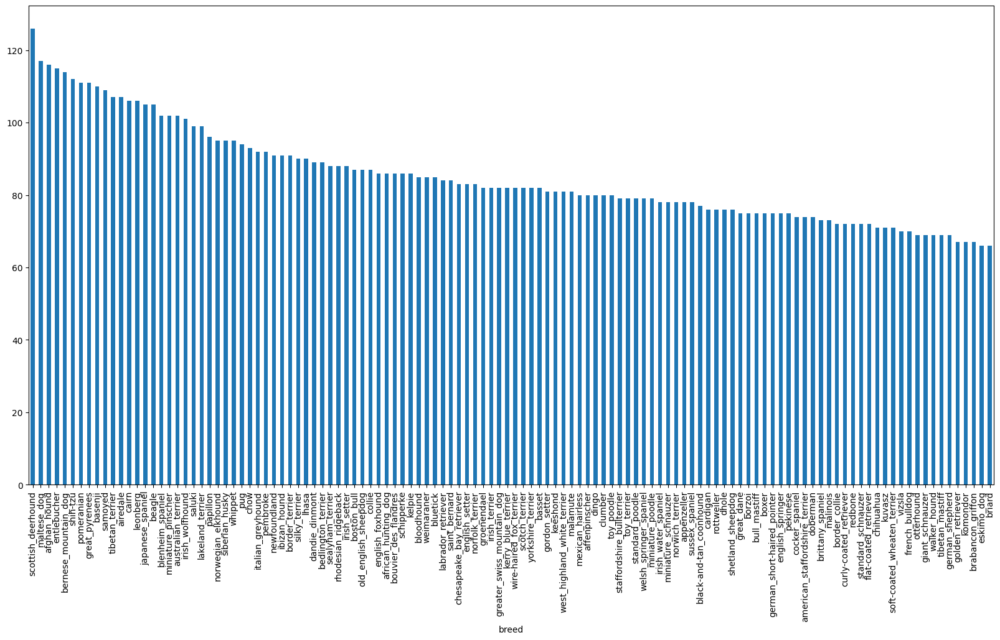

In [7]:
# How many images are there of each breed?
labels_csv["breed"].value_counts().plot.bar(figsize=(20,10))

In [8]:
labels_csv['breed'].value_counts().median()

82.0

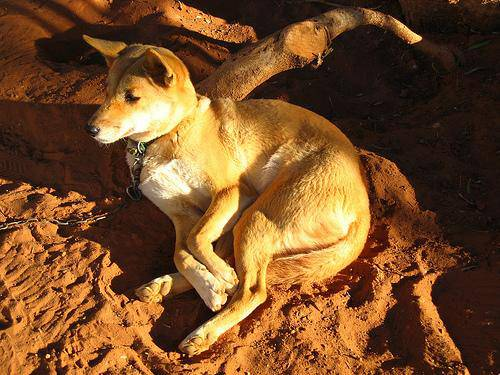

In [9]:
# Let's View an Image
from IPython.display import Image
Image("drive/My Drive/Colab Notebooks/train/001513dfcb2ffafc82cccf4d8bbaba97.jpg")

**Getting Images and Their Labels:**

Let's get a list of all our image file names.

In [10]:
labels_csv.head()

,id,breed
0,000bec180eb18c7604dcecc8fe0dba07,boston_bull
1,001513dfcb2ffafc82cccf4d8bbaba97,dingo
2,001cdf01b096e06d78e9e5112d419397,pekinese
3,00214f311d5d2247d5dfe4fe24b2303d,bluetick
4,0021f9ceb3235effd7fcde7f7538ed62,golden_retriever


In [11]:
# Create Pathnames for image ID's

filenames = ["drive/My Drive/Colab Notebooks/train/" + fname + ".jpg" for fname in labels_csv["id"]]

# Check the first 10:
filenames[:10]

['drive/My Drive/Colab Notebooks/train/000bec180eb18c7604dcecc8fe0dba07.jpg',
 'drive/My Drive/Colab Notebooks/train/001513dfcb2ffafc82cccf4d8bbaba97.jpg',
 'drive/My Drive/Colab Notebooks/train/001cdf01b096e06d78e9e5112d419397.jpg',
 'drive/My Drive/Colab Notebooks/train/00214f311d5d2247d5dfe4fe24b2303d.jpg',
 'drive/My Drive/Colab Notebooks/train/0021f9ceb3235effd7fcde7f7538ed62.jpg',
 'drive/My Drive/Colab Notebooks/train/002211c81b498ef88e1b40b9abf84e1d.jpg',
 'drive/My Drive/Colab Notebooks/train/00290d3e1fdd27226ba27a8ce248ce85.jpg',
 'drive/My Drive/Colab Notebooks/train/002a283a315af96eaea0e28e7163b21b.jpg',
 'drive/My Drive/Colab Notebooks/train/003df8b8a8b05244b1d920bb6cf451f9.jpg',
 'drive/My Drive/Colab Notebooks/train/0042188c895a2f14ef64a918ed9c7b64.jpg']

In [12]:
# Check whether number of filenames matches number of actual image files:
import os

if len(os.listdir("drive/My Drive/Colab Notebooks/train/")) == len(filenames):
  print("Filenames match actual amount of files. Proceed.")
else:
  print("Filenames do not match actual amount of files. Check target directory.")

Filenames match actual amount of files. Proceed.


Since we've now got our training image filepaths in a list, let's prepare our labels.

In [13]:
import numpy as np

labels = labels_csv["breed"]
labels = np.array(labels)
labels

array(['boston_bull', 'dingo', 'pekinese', ..., 'airedale',
       'miniature_pinscher', 'chesapeake_bay_retriever'], dtype=object)

In [14]:
# See if number of labels matches the number of filenames
if len(labels) == len(filenames):
  print("Number of labels matches number of filenames!")
else:
  print("Number of labels does not match number of filenames. Check data directories.")

Number of labels matches number of filenames!


In [15]:
# Find the unique label values.

unique_breeds = np.unique(labels)
len(unique_breeds)

120

In [16]:
# Turn a single label into an array of booleans.

print(labels[0])
labels[0] == unique_breeds

boston_bull


array([False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False,  True, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False])

In [17]:
# Turn every label into a boolean array:
boolean_labels = [label == unique_breeds for label in labels]
boolean_labels[:2]

[array([False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False,  True, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False]),
 array([False, False, False, False, False, Fal

In [18]:
len(boolean_labels)

10222

In [19]:
# Example: Turning boolean arrays into integers.

print(labels[0]) # original label
print(np.where(unique_breeds == labels[0])) # index where label occurs.
print(boolean_labels[0].argmax()) # index where label occurs in boolean array
print(boolean_labels[0].astype(int)) # there will be a 1 where the sample label occurs.

boston_bull
(array([19]),)
19
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0]


In [20]:
print(labels[2]) # original label
print(np.where(unique_breeds == labels[2])) # index where label occurs.
print(boolean_labels[2].argmax()) # index where label occurs in boolean array
print(boolean_labels[2].astype(int)) # there will be a 1 where the sample label occurs.

pekinese
(array([85]),)
85
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0]


In [21]:
filenames[:10]

['drive/My Drive/Colab Notebooks/train/000bec180eb18c7604dcecc8fe0dba07.jpg',
 'drive/My Drive/Colab Notebooks/train/001513dfcb2ffafc82cccf4d8bbaba97.jpg',
 'drive/My Drive/Colab Notebooks/train/001cdf01b096e06d78e9e5112d419397.jpg',
 'drive/My Drive/Colab Notebooks/train/00214f311d5d2247d5dfe4fe24b2303d.jpg',
 'drive/My Drive/Colab Notebooks/train/0021f9ceb3235effd7fcde7f7538ed62.jpg',
 'drive/My Drive/Colab Notebooks/train/002211c81b498ef88e1b40b9abf84e1d.jpg',
 'drive/My Drive/Colab Notebooks/train/00290d3e1fdd27226ba27a8ce248ce85.jpg',
 'drive/My Drive/Colab Notebooks/train/002a283a315af96eaea0e28e7163b21b.jpg',
 'drive/My Drive/Colab Notebooks/train/003df8b8a8b05244b1d920bb6cf451f9.jpg',
 'drive/My Drive/Colab Notebooks/train/0042188c895a2f14ef64a918ed9c7b64.jpg']

## Split Data Into Training and Validation:

Since the dataset from Kaggle doesn't come with a validation set, we're going to create our own.

In [22]:
# Setup X & y variables.

X = filenames
y = boolean_labels

In [23]:
len(filenames)

10222

We're going to start off experimenting with 1000 images and increase as needed.

In [24]:
# Set number of images to use for experimenting:

NUM_IMAGES = 1000 #@param{type:"slider", min:1000, max:10000, step:1000}

In [25]:
# Let's split our data into train and validation sets.

from sklearn.model_selection import train_test_split

# Split them into training and validation of total size NUM_IMAGES
X_train, X_val, y_train, y_val = train_test_split(X[:NUM_IMAGES],
                                                  y[:NUM_IMAGES],
                                                  test_size=0.2,
                                                  random_state=42)

len(X_train), len(y_train), len(X_val), len(y_val)

(800, 800, 200, 200)

In [26]:
# Let's have a geez at the training data:

X_train[:2], y_train[:2]

(['drive/My Drive/Colab Notebooks/train/00bee065dcec471f26394855c5c2f3de.jpg',
  'drive/My Drive/Colab Notebooks/train/0d2f9e12a2611d911d91a339074c8154.jpg'],
 [array([False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False,  True,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False

## Preprocessing Images (turning images into Tensors)

To preprocess our images into Tensors, we're going to write a function which does a few things:
1. Take an image filepath as input
2. Use TensorFlow to read the file and save it to a variable, `image`.
3. Turn our `image`, (a jpg) into Tensors.
4. Resize the `image` to be a shape of (224, 224)
5. Return the modified `image`.


Before we do, let's see what importing an image looks like.

In [27]:
# Convert Image to NumPy array:
from matplotlib.pyplot import imread

image = imread(filenames[42])
image.shape

(257, 350, 3)

array([[[ 89, 137,  89],
        [ 76, 124,  76],
        [ 63, 111,  61],
        ...,
        [ 77, 133,  86],
        [ 76, 134,  86],
        [ 76, 134,  86]],

       [[ 72, 119,  75],
        [ 67, 114,  68],
        [ 63, 110,  64],
        ...,
        [ 75, 131,  84],
        [ 74, 132,  84],
        [ 74, 132,  84]],

       [[ 56, 104,  66],
        [ 58, 106,  68],
        [ 64, 112,  74],
        ...,
        [ 71, 127,  82],
        [ 73, 129,  84],
        [ 74, 130,  85]],

       ...,

       [[  2,  11,  10],
        [  5,  14,  11],
        [  8,  14,  14],
        ...,
        [120, 113,  67],
        [126, 118,  71],
        [122, 114,  67]],

       [[  0,   3,   7],
        [  2,   7,  10],
        [  3,   9,   7],
        ...,
        [105,  98,  54],
        [112, 104,  58],
        [111, 103,  57]],

       [[ 16,  18,  30],
        [ 16,  19,  24],
        [ 15,  20,  14],
        ...,
        [101,  92,  51],
        [ 97,  88,  47],
        [120, 111,  70]]], dtype=uint8)
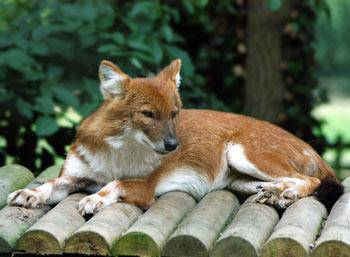

In [28]:
image

In [29]:
# Turn image into Tensor
tf.constant(image)[:2]

<tf.Tensor: shape=(2, 350, 3), dtype=uint8, numpy=
array([[[ 89, 137,  89],
        [ 76, 124,  76],
        [ 63, 111,  61],
        ...,
        [ 77, 133,  86],
        [ 76, 134,  86],
        [ 76, 134,  86]],

       [[ 72, 119,  75],
        [ 67, 114,  68],
        [ 63, 110,  64],
        ...,
        [ 75, 131,  84],
        [ 74, 132,  84],
        [ 74, 132,  84]]], dtype=uint8)>

Now we've seen what an image looks like as a Tensor, let's make a function to preprocess them.

1. Take an image filepath as input
2. Use TensorFlow to read the file and save it to a variable, <code> image </code>
3. Turn our <code> image </code> (a jpg) into Tensors
4. Resize the <code> image </code> to be a shape of (224, 224).
5. Return the modified <code> image </code>

In [30]:
tensor = tf.io.read_file(filenames[26])
tensor

<tf.Tensor: shape=(), dtype=string, numpy=b'\xff\xd8\xff\xe0\x00\x10JFIF\x00\x01\x01\x00\x00\x01\x00\x01\x00\x00\xff\xdb\x00C\x00\n\x07\x07\x08\x07\x06\n\x08\x08\x08\x0b\n\n\x0b\x0e\x18\x10\x0e\r\r\x0e\x1d\x15\x16\x11\x18#\x1f%$"\x1f"!&+7/&)4)!"0A149;>>>%.DIC<H7=>;\xff\xdb\x00C\x01\n\x0b\x0b\x0e\r\x0e\x1c\x10\x10\x1c;("(;;;;;;;;;;;;;;;;;;;;;;;;;;;;;;;;;;;;;;;;;;;;;;;;;;\xff\xc0\x00\x11\x08\x01\xf4\x01w\x03\x01"\x00\x02\x11\x01\x03\x11\x01\xff\xc4\x00\x1f\x00\x00\x01\x05\x01\x01\x01\x01\x01\x01\x00\x00\x00\x00\x00\x00\x00\x00\x01\x02\x03\x04\x05\x06\x07\x08\t\n\x0b\xff\xc4\x00\xb5\x10\x00\x02\x01\x03\x03\x02\x04\x03\x05\x05\x04\x04\x00\x00\x01}\x01\x02\x03\x00\x04\x11\x05\x12!1A\x06\x13Qa\x07"q\x142\x81\x91\xa1\x08#B\xb1\xc1\x15R\xd1\xf0$3br\x82\t\n\x16\x17\x18\x19\x1a%&\'()*456789:CDEFGHIJSTUVWXYZcdefghijstuvwxyz\x83\x84\x85\x86\x87\x88\x89\x8a\x92\x93\x94\x95\x96\x97\x98\x99\x9a\xa2\xa3\xa4\xa5\xa6\xa7\xa8\xa9\xaa\xb2\xb3\xb4\xb5\xb6\xb7\xb8\xb9\xba\xc2\xc3\xc4\xc5\xc6\xc7\xc8\xc9\xca

In [31]:
# Define image size
IMG_SIZE = 224

# Create a function for preprocessing images
def process_image(image_path):
  """
  Takes an image file path and turns it into a Tensor.
  """
  # Read in an image file.
  image =  tf.io.read_file(image_path)

  # Turn the jpeg image into numerical Tensors with 3 colour channels (Red, Green, and Blue)
  image = tf.image.decode_jpeg(image, channels=3)

  # Normalization: Convert the color channel values from 0-255 to 0-1 values.
  image = tf.image.convert_image_dtype(image, tf.float32)

  # Resize the image to our desired value (224, 224)
  image = tf.image.resize(image, size=[IMG_SIZE, IMG_SIZE])

  return image

<h1> Data Batching </h1>

TensorFlow likes data in batches.

**Batch**: A small portion of your data.
- 32 is the standard size for deep learning.
- Yann Lecun (batch size)
- Jeremy Howard (batch size) - Convolutional Neural Networks.

<h2> Turning Our Data Into Batches </h2>

Why turn data into batches?

Taking a small portion - 32 images,

Let's say you're trying to process 10,000+ images in one go... they all might not fit into memory.

So that's why we batch 32 images at a time. (you can manually adjust the batch size if need be!)

In order to use TensorFlow effectively, we need our data in the form of Tensor tuples which look like this:
`(image, label)` .

In [32]:
# Create a simple function to return a tuple (image, label)

def get_image_label(image_path, label):
  """
  Takes an image file path name and the associated label,
  processes the image and returns a tuple of (image, label).
  """
  image = process_image(image_path)
  return image, label


In [33]:
# Demo of the above
(process_image(X[42]), tf.constant(y[42]))

(<tf.Tensor: shape=(224, 224, 3), dtype=float32, numpy=
 array([[[0.3264178 , 0.5222886 , 0.3232816 ],
         [0.2537167 , 0.44366494, 0.24117757],
         [0.25699762, 0.4467087 , 0.23893751],
         ...,
         [0.29325107, 0.5189916 , 0.3215547 ],
         [0.29721776, 0.52466875, 0.33030328],
         [0.2948505 , 0.5223015 , 0.33406618]],
 
        [[0.25903144, 0.4537807 , 0.27294815],
         [0.24375686, 0.4407019 , 0.2554778 ],
         [0.2838985 , 0.47213382, 0.28298813],
         ...,
         [0.2785345 , 0.5027992 , 0.31004712],
         [0.28428748, 0.5108719 , 0.32523635],
         [0.28821915, 0.5148036 , 0.32916805]],
 
        [[0.20941195, 0.40692952, 0.25792548],
         [0.24045378, 0.43900946, 0.2868911 ],
         [0.29001117, 0.47937486, 0.32247734],
         ...,
         [0.26074055, 0.48414773, 0.30125174],
         [0.27101526, 0.49454468, 0.32096273],
         [0.27939945, 0.5029289 , 0.32934693]],
 
        ...,
 
        [[0.00634795, 0.03442048


## Turning Image Label Pairs Into Batches!



Now we've got a way to turn our data into tuples of Tensors in the form `(image, label)`, let's make a function to turn all of our data (`X` & `y`) into batches!

In [34]:
# Define the batch size - 32 is a good start!
BATCH_SIZE = 32

# Create a function to turn data into batches.
def create_data_batches(X, y=None, batch_size=BATCH_SIZE, valid_data=False, test_data=False):
  """
  Rubber Ducking: If you're having trouble with code, write it out in language, and then write it in code.

  Creates batches of data out of image (X) and label (y) pairs.
  Shuffles the data if it's training data but doesn't shuffle it if it's validation data.
  Also accepts test data as input (no labels).
  """

  # If the data is a test dataset, we probably don't have labels.
  if test_data:
      print("Creating test data batches...")
      data = tf.data.Dataset.from_tensor_slices((tf.constant(X))) # only filepaths (no labels!)
      data_batch = data.map(process_image).batch(BATCH_SIZE)
      return data_batch

  # If the data is a valid dataset, we don't need to shuffle it.
  elif valid_data:
      print("Creating validation data batches...")
      data = tf.data.Dataset.from_tensor_slices((tf.constant(X), # filepaths
      tf.constant(y) # labels
      ))
      data_batch = data.map(get_image_label).batch(BATCH_SIZE)
      return data_batch

  else:
      print("Creating training data batches...")
      # Turn filepaths and labels into Tensors
      data = tf.data.Dataset.from_tensor_slices((tf.constant(X), tf.constant(y)))

      # Shuffle path names and labels before mapping image process function is faster than shuffling images.
      data = data.shuffle(buffer_size=len(X))

      # Create (image, label) tuples, (this also turns the image path into a preprocessed image)
      data = data.map(get_image_label)

      # Turn the training data into batches
      data_batch = data.batch(BATCH_SIZE)

      return data_batch

In [35]:
# Create training and validation data batches

train_data = create_data_batches(X_train, y_train)
val_data = create_data_batches(X_val, y_val, valid_data=True)

Creating training data batches...
Creating validation data batches...


In [36]:
# Check out the different attributes of our data batches

train_data.element_spec, val_data.element_spec

((TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None),
  TensorSpec(shape=(None, 120), dtype=tf.bool, name=None)),
 (TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None),
  TensorSpec(shape=(None, 120), dtype=tf.bool, name=None)))

## Visualizing Data Batches

Our data is now in batches, however, these can be a little hard to understand & comprehend. Let's visualize them!

In [37]:
%matplotlib inline
import matplotlib.pyplot as plt

# Create a function for viewing images in a data batch.

def show_25_images(images, labels):
  """
  Displays a plot of 25 images and their labels from a data batch.
  """
  # Setup the figure:
  plt.figure(figsize=(10,10))
  # Loop through 25 (for displaying 25 images)
  for i in range(25):
    # Create subplots (5 rows, 5 columns)
    ax = plt.subplot(5,5,i+1)
    # Display an image
    plt.imshow(images[i])
    # Add the image label as the title.
    plt.title(unique_breeds[labels[i].argmax()])
    # Turn the grid lines off
    plt.axis( "off")

In [38]:
train_images, train_labels = next(train_data.as_numpy_iterator())

In [39]:
len(train_images), len(train_labels)

(32, 32)

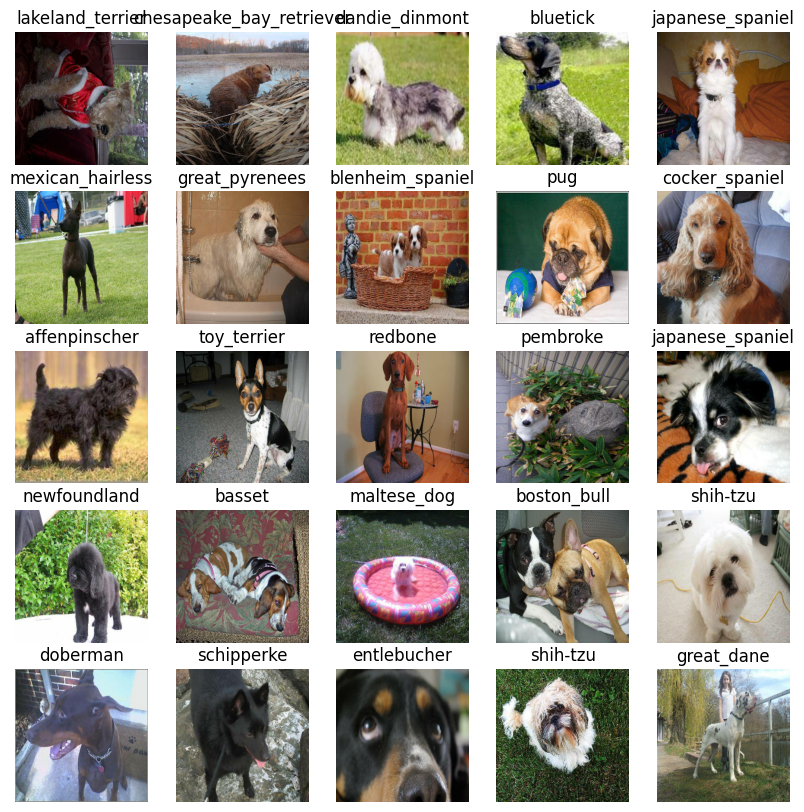

In [40]:
# Visualization of our Training Data
show_25_images(train_images, train_labels)

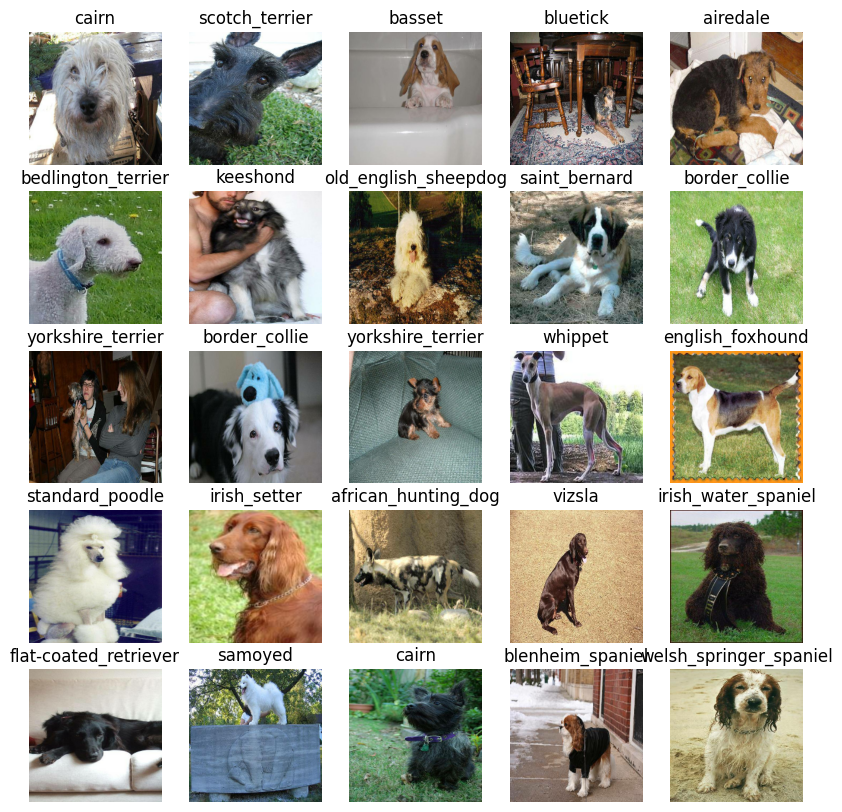

In [41]:
# Now let's visualize our validation set

val_images, val_labels = next(val_data.as_numpy_iterator())
show_25_images(val_images, val_labels)

<h1> Now Let's Build A Deep Learning Model! </h1>

1. Get data ready (turn into Tensors).
2. Pick a model (to suit your problem).
3. Fit the model to the data & make a prediction.
4. Evaluate the model.
5. Improve through experimentation.
6. Save and reload your trained model.

**Before we build a model, there are a few things we need to define:**
- The input shape (our images shape, in the form of Tensors) to our model.
- The output shape (image labels, in the form of Tensors) of our model.
- The URL of the model we want to use. (**Transfer Learning**)

TensorFlow Keras: High-level API for high-level deep learning:
https://www.tensorflow.org/guide/keras

In [42]:
# Setup Input Shape to the Model:
'''
IMG_SIZE = 224
TensorSpec = (None, 224, 224, 3)
Finding Tensor Spec: train_data/val_data.element_spec
'''

INPUT_SHAPE = [None, IMG_SIZE, IMG_SIZE, 3] # batch, height, width, colour channels

# Setup output shape of our model:
OUTPUT_SHAPE = len(unique_breeds)

# Setup model URL from TensorFlow Hub
MODEL_URL = "https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/4"

In [43]:
len(unique_breeds)

120

Now we've got our inputs, outputs, and model ready to go. Let's put them together into a Keras deep learning model!

Knowing this, let's create a function which:
1. Takes the input shape, output shape, and the model we've chosen as input, or as parameters.
2. Defines the layers in a Keras model in sequential fashion. (do this first, then this, then that.)
3. Compiles the model (says it should be evaluated and improved).
4. Builds the model (tells the model the kind/input shape it'll be getting).
5. Returns the model.

In [44]:
import tf_keras
import tensorflow_hub as hub

# Create a function which builds a Keras model
def create_model(input_shape=INPUT_SHAPE, output_shape=OUTPUT_SHAPE, model_url=MODEL_URL):
  print("Building model with:", MODEL_URL)

  # Setup the model layers
  model = tf_keras.Sequential([
    hub.KerasLayer(MODEL_URL),
    tf_keras.layers.Dense(units=OUTPUT_SHAPE,
                          activation="softmax") # Layer 2 (output layer)
  ])

  # Compile the model
  model.compile(
      loss=tf_keras.losses.CategoricalCrossentropy(), # Our model wants to reduce this (how wrong its guesses are)
      optimizer=tf_keras.optimizers.Adam(), # A friend telling our model how to improve its guesses
      metrics=["accuracy"] # We'd like this to go up
  )

  # Build the model
  model.build(INPUT_SHAPE) # Let the model know what kind of inputs it'll be getting

  return model


In [45]:
model = create_model()

Building model with: https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/4


In [46]:
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 module_wrapper (ModuleWrap  (None, 1001)              5432713   
 per)                                                            
                                                                 
 dense (Dense)               (None, 120)               120240    
                                                                 
Total params: 5552953 (21.18 MB)
Trainable params: 120240 (469.69 KB)
Non-trainable params: 5432713 (20.72 MB)
_________________________________________________________________


In [47]:
outputs = np.ones(shape=(1,1,1280))
outputs

array([[[1., 1., 1., ..., 1., 1., 1.]]])

<h1> Callbacks In Our Models: </h1>

Callbacks are helper functions a model can use during training to do such things such as save its progress, check its progress, or stop training early if a model stops improving.

We'll create 2 callbacks, one for TensorBoard which helps track our models progress, and another for early stopping which prevents our models from training for too long.

### TensorBoard Callback:

To setup a TensorBoard callback, we need to do 3 things:
1. Load the TensorBoard notebook extension. ✅
2. Create a TensorBoard callback which is able to save logs to a directory and pass it to our model's `fit()` function. ✅
3. Visualize our models training logs with the `%tensorboard` magic function (we'll do this after model training).

In [48]:
# Load TensorBoard notebook extension:
%load_ext tensorboard

In [49]:
import datetime

# Create a function to build a TensorBoard callback
def create_tensorboard_callback():
  # Create a log directory for storing TensorBoard logs:
  logdir = os.path.join("drive/My Drive/Colab Notebooks/Logs",
                        # Make it so the logs get tracked whenever we run an experiment.
                        datetime.datetime.now().strftime("%Y/%m/%d - %H:%M:%S"))
  return tf.keras.callbacks.TensorBoard(logdir)

<h1> Early Stopping Callback </h1>

Early stopping helps stop our model from overfitting by stopping training if a certain evaluation metric stops improving.

https://www.tensorflow.org/api_docs/python/tf/keras/callbacks/EarlyStopping


In [50]:
early_stopping = tf.keras.callbacks.EarlyStopping(monitor="val accuracy",
                                                  patience=3)

<h1> Training a Deep Learning Neural Network </h1>

Our first model is only going to train on 1000 images, to make sure everything is working.
- **Number of Epochs:**

In [51]:
## Training a model (on subset of data)

NUM_EPOCHS = 100 # @param {"type":"slider","min":10,"max":100,"step":100}

In [52]:
# Check to make sure we're still running on a GPU:

print("GPU", "available (YESSSS!!!!)" if tf.config.list_physical_devices("GPU") else "not available :C")

GPU available (YESSSS!!!!)


Let's create a function which trains a model.

- Create a model using `create_model()`
- Setup a TensorBoard callback using `create_tensorboard_callback()`
- Call the `fit()` function on our model passing it the training data, validation data, number of epochs to train for (`NUM_EPOCHS`) and the callbacks we'd like to use.
- Return the model.

In [53]:
# Build a function to train and return a trained model:
def train_model():
  """
  Trains a given model and returns the trained version.
  """
  # Create a model:
  model = create_model()

  # Create new TensorBoard session everytime we train a model:
  tensorboard = create_tensorboard_callback()

  # Fit the model to the data passing it the callbacks we created.
  model.fit(x=train_data,
            epochs=NUM_EPOCHS,
            validation_data=val_data,
            validation_freq=1,
            # once an epoch
            callbacks=[tensorboard, early_stopping])

  # Return the fitted model
  return model

In [54]:
model = train_model()

Building model with: https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/4


Layer ModuleWrapper was created by passing
non-serializable argument values in `__init__()`,
and therefore the layer must override `get_config()` in
order to be serializable. Please implement `get_config()`.

Example:

class CustomLayer(keras.layers.Layer):
    def __init__(self, arg1, arg2, **kwargs):
        super().__init__(**kwargs)
        self.arg1 = arg1
        self.arg2 = arg2

    def get_config(self):
        config = super().get_config()
        config.update({
            "arg1": self.arg1,
            "arg2": self.arg2,
        })
        return config


Epoch 1/100
25/25 [==============================] - ETA: 0s - loss: 4.5781 - accuracy: 0.0838

25/25 [==============================] - 302s 9s/step - loss: 4.5781 - accuracy: 0.0838 - val_loss: 3.3769 - val_accuracy: 0.2650
Epoch 2/100
25/25 [==============================] - ETA: 0s - loss: 1.6351 - accuracy: 0.6825

25/25 [==============================] - 4s 167ms/step - loss: 1.6351 - accuracy: 0.6825 - val_loss: 2.0902 - val_accuracy: 0.5100
Epoch 3/100
25/25 [==============================] - ETA: 0s - loss: 0.5737 - accuracy: 0.9425

25/25 [==============================] - 5s 204ms/step - loss: 0.5737 - accuracy: 0.9425 - val_loss: 1.6319 - val_accuracy: 0.5950
Epoch 4/100
25/25 [==============================] - ETA: 0s - loss: 0.2558 - accuracy: 0.9850

25/25 [==============================] - 5s 212ms/step - loss: 0.2558 - accuracy: 0.9850 - val_loss: 1.4673 - val_accuracy: 0.6350
Epoch 5/100
25/25 [==============================] - ETA: 0s - loss: 0.1506 - accuracy: 0.9975

25/25 [==============================] - 4s 166ms/step - loss: 0.1506 - accuracy: 0.9975 - val_loss: 1.4034 - val_accuracy: 0.6600
Epoch 6/100
25/25 [==============================] - ETA: 0s - loss: 0.1024 - accuracy: 1.0000

25/25 [==============================] - 4s 162ms/step - loss: 0.1024 - accuracy: 1.0000 - val_loss: 1.3453 - val_accuracy: 0.6550
Epoch 7/100
25/25 [==============================] - ETA: 0s - loss: 0.0766 - accuracy: 1.0000

25/25 [==============================] - 6s 220ms/step - loss: 0.0766 - accuracy: 1.0000 - val_loss: 1.3174 - val_accuracy: 0.6550
Epoch 8/100
25/25 [==============================] - ETA: 0s - loss: 0.0605 - accuracy: 1.0000

25/25 [==============================] - 4s 164ms/step - loss: 0.0605 - accuracy: 1.0000 - val_loss: 1.2959 - val_accuracy: 0.6550
Epoch 9/100
25/25 [==============================] - ETA: 0s - loss: 0.0495 - accuracy: 1.0000

25/25 [==============================] - 5s 211ms/step - loss: 0.0495 - accuracy: 1.0000 - val_loss: 1.2764 - val_accuracy: 0.6600
Epoch 10/100
25/25 [==============================] - ETA: 0s - loss: 0.0417 - accuracy: 1.0000

25/25 [==============================] - 5s 196ms/step - loss: 0.0417 - accuracy: 1.0000 - val_loss: 1.2665 - val_accuracy: 0.6650
Epoch 11/100
25/25 [==============================] - ETA: 0s - loss: 0.0359 - accuracy: 1.0000

25/25 [==============================] - 4s 169ms/step - loss: 0.0359 - accuracy: 1.0000 - val_loss: 1.2576 - val_accuracy: 0.6700
Epoch 12/100
25/25 [==============================] - ETA: 0s - loss: 0.0314 - accuracy: 1.0000

25/25 [==============================] - 5s 186ms/step - loss: 0.0314 - accuracy: 1.0000 - val_loss: 1.2452 - val_accuracy: 0.6650
Epoch 13/100
25/25 [==============================] - ETA: 0s - loss: 0.0275 - accuracy: 1.0000

25/25 [==============================] - 4s 168ms/step - loss: 0.0275 - accuracy: 1.0000 - val_loss: 1.2365 - val_accuracy: 0.6850
Epoch 14/100
25/25 [==============================] - ETA: 0s - loss: 0.0245 - accuracy: 1.0000

25/25 [==============================] - 4s 147ms/step - loss: 0.0245 - accuracy: 1.0000 - val_loss: 1.2285 - val_accuracy: 0.6800
Epoch 15/100
25/25 [==============================] - ETA: 0s - loss: 0.0221 - accuracy: 1.0000

25/25 [==============================] - 5s 187ms/step - loss: 0.0221 - accuracy: 1.0000 - val_loss: 1.2239 - val_accuracy: 0.6850
Epoch 16/100
25/25 [==============================] - ETA: 0s - loss: 0.0199 - accuracy: 1.0000

25/25 [==============================] - 4s 147ms/step - loss: 0.0199 - accuracy: 1.0000 - val_loss: 1.2150 - val_accuracy: 0.6950
Epoch 17/100
25/25 [==============================] - ETA: 0s - loss: 0.0182 - accuracy: 1.0000

25/25 [==============================] - 4s 147ms/step - loss: 0.0182 - accuracy: 1.0000 - val_loss: 1.2146 - val_accuracy: 0.7000
Epoch 18/100
25/25 [==============================] - ETA: 0s - loss: 0.0167 - accuracy: 1.0000

25/25 [==============================] - 6s 222ms/step - loss: 0.0167 - accuracy: 1.0000 - val_loss: 1.2106 - val_accuracy: 0.6950
Epoch 19/100
25/25 [==============================] - ETA: 0s - loss: 0.0153 - accuracy: 1.0000

25/25 [==============================] - 4s 168ms/step - loss: 0.0153 - accuracy: 1.0000 - val_loss: 1.2036 - val_accuracy: 0.6950
Epoch 20/100
25/25 [==============================] - ETA: 0s - loss: 0.0141 - accuracy: 1.0000

25/25 [==============================] - 5s 202ms/step - loss: 0.0141 - accuracy: 1.0000 - val_loss: 1.1973 - val_accuracy: 0.7000
Epoch 21/100
25/25 [==============================] - ETA: 0s - loss: 0.0131 - accuracy: 1.0000

25/25 [==============================] - 4s 175ms/step - loss: 0.0131 - accuracy: 1.0000 - val_loss: 1.1969 - val_accuracy: 0.7000
Epoch 22/100
25/25 [==============================] - ETA: 0s - loss: 0.0122 - accuracy: 1.0000

25/25 [==============================] - 4s 172ms/step - loss: 0.0122 - accuracy: 1.0000 - val_loss: 1.1940 - val_accuracy: 0.7000
Epoch 23/100
25/25 [==============================] - ETA: 0s - loss: 0.0114 - accuracy: 1.0000

25/25 [==============================] - 5s 203ms/step - loss: 0.0114 - accuracy: 1.0000 - val_loss: 1.1909 - val_accuracy: 0.6950
Epoch 24/100
25/25 [==============================] - ETA: 0s - loss: 0.0107 - accuracy: 1.0000

25/25 [==============================] - 4s 176ms/step - loss: 0.0107 - accuracy: 1.0000 - val_loss: 1.1893 - val_accuracy: 0.6950
Epoch 25/100
25/25 [==============================] - ETA: 0s - loss: 0.0100 - accuracy: 1.0000

25/25 [==============================] - 4s 177ms/step - loss: 0.0100 - accuracy: 1.0000 - val_loss: 1.1858 - val_accuracy: 0.7050
Epoch 26/100
25/25 [==============================] - ETA: 0s - loss: 0.0094 - accuracy: 1.0000

25/25 [==============================] - 4s 175ms/step - loss: 0.0094 - accuracy: 1.0000 - val_loss: 1.1850 - val_accuracy: 0.7050
Epoch 27/100
25/25 [==============================] - ETA: 0s - loss: 0.0089 - accuracy: 1.0000

25/25 [==============================] - 4s 154ms/step - loss: 0.0089 - accuracy: 1.0000 - val_loss: 1.1832 - val_accuracy: 0.7050
Epoch 28/100
25/25 [==============================] - ETA: 0s - loss: 0.0084 - accuracy: 1.0000

25/25 [==============================] - 4s 174ms/step - loss: 0.0084 - accuracy: 1.0000 - val_loss: 1.1815 - val_accuracy: 0.7050
Epoch 29/100
25/25 [==============================] - ETA: 0s - loss: 0.0079 - accuracy: 1.0000

25/25 [==============================] - 5s 186ms/step - loss: 0.0079 - accuracy: 1.0000 - val_loss: 1.1784 - val_accuracy: 0.7050
Epoch 30/100
25/25 [==============================] - ETA: 0s - loss: 0.0075 - accuracy: 1.0000

25/25 [==============================] - 4s 172ms/step - loss: 0.0075 - accuracy: 1.0000 - val_loss: 1.1789 - val_accuracy: 0.7050
Epoch 31/100
25/25 [==============================] - ETA: 0s - loss: 0.0071 - accuracy: 1.0000

25/25 [==============================] - 4s 164ms/step - loss: 0.0071 - accuracy: 1.0000 - val_loss: 1.1762 - val_accuracy: 0.7050
Epoch 32/100
25/25 [==============================] - ETA: 0s - loss: 0.0068 - accuracy: 1.0000

25/25 [==============================] - 5s 194ms/step - loss: 0.0068 - accuracy: 1.0000 - val_loss: 1.1754 - val_accuracy: 0.7050
Epoch 33/100
25/25 [==============================] - ETA: 0s - loss: 0.0065 - accuracy: 1.0000

25/25 [==============================] - 4s 161ms/step - loss: 0.0065 - accuracy: 1.0000 - val_loss: 1.1751 - val_accuracy: 0.7000
Epoch 34/100
25/25 [==============================] - ETA: 0s - loss: 0.0062 - accuracy: 1.0000

25/25 [==============================] - 5s 199ms/step - loss: 0.0062 - accuracy: 1.0000 - val_loss: 1.1742 - val_accuracy: 0.7000
Epoch 35/100
25/25 [==============================] - ETA: 0s - loss: 0.0059 - accuracy: 1.0000

25/25 [==============================] - 4s 176ms/step - loss: 0.0059 - accuracy: 1.0000 - val_loss: 1.1734 - val_accuracy: 0.7000
Epoch 36/100
25/25 [==============================] - ETA: 0s - loss: 0.0056 - accuracy: 1.0000

25/25 [==============================] - 4s 153ms/step - loss: 0.0056 - accuracy: 1.0000 - val_loss: 1.1723 - val_accuracy: 0.7000
Epoch 37/100
25/25 [==============================] - ETA: 0s - loss: 0.0054 - accuracy: 1.0000

25/25 [==============================] - 5s 202ms/step - loss: 0.0054 - accuracy: 1.0000 - val_loss: 1.1715 - val_accuracy: 0.7000
Epoch 38/100
25/25 [==============================] - ETA: 0s - loss: 0.0052 - accuracy: 1.0000

25/25 [==============================] - 4s 152ms/step - loss: 0.0052 - accuracy: 1.0000 - val_loss: 1.1703 - val_accuracy: 0.7000
Epoch 39/100
25/25 [==============================] - ETA: 0s - loss: 0.0049 - accuracy: 1.0000

25/25 [==============================] - 4s 173ms/step - loss: 0.0049 - accuracy: 1.0000 - val_loss: 1.1699 - val_accuracy: 0.7000
Epoch 40/100
25/25 [==============================] - ETA: 0s - loss: 0.0047 - accuracy: 1.0000

25/25 [==============================] - 5s 208ms/step - loss: 0.0047 - accuracy: 1.0000 - val_loss: 1.1688 - val_accuracy: 0.7000
Epoch 41/100
25/25 [==============================] - ETA: 0s - loss: 0.0046 - accuracy: 1.0000

25/25 [==============================] - 4s 148ms/step - loss: 0.0046 - accuracy: 1.0000 - val_loss: 1.1692 - val_accuracy: 0.7000
Epoch 42/100
25/25 [==============================] - ETA: 0s - loss: 0.0044 - accuracy: 1.0000

25/25 [==============================] - 5s 211ms/step - loss: 0.0044 - accuracy: 1.0000 - val_loss: 1.1683 - val_accuracy: 0.7000
Epoch 43/100
25/25 [==============================] - ETA: 0s - loss: 0.0042 - accuracy: 1.0000

25/25 [==============================] - 4s 168ms/step - loss: 0.0042 - accuracy: 1.0000 - val_loss: 1.1680 - val_accuracy: 0.7000
Epoch 44/100
25/25 [==============================] - ETA: 0s - loss: 0.0041 - accuracy: 1.0000

25/25 [==============================] - 5s 209ms/step - loss: 0.0041 - accuracy: 1.0000 - val_loss: 1.1667 - val_accuracy: 0.7000
Epoch 45/100
25/25 [==============================] - ETA: 0s - loss: 0.0039 - accuracy: 1.0000

25/25 [==============================] - 4s 148ms/step - loss: 0.0039 - accuracy: 1.0000 - val_loss: 1.1661 - val_accuracy: 0.7000
Epoch 46/100
25/25 [==============================] - ETA: 0s - loss: 0.0038 - accuracy: 1.0000

25/25 [==============================] - 5s 196ms/step - loss: 0.0038 - accuracy: 1.0000 - val_loss: 1.1663 - val_accuracy: 0.7000
Epoch 47/100
25/25 [==============================] - ETA: 0s - loss: 0.0036 - accuracy: 1.0000

25/25 [==============================] - 4s 146ms/step - loss: 0.0036 - accuracy: 1.0000 - val_loss: 1.1662 - val_accuracy: 0.7000
Epoch 48/100
25/25 [==============================] - ETA: 0s - loss: 0.0035 - accuracy: 1.0000

25/25 [==============================] - 4s 142ms/step - loss: 0.0035 - accuracy: 1.0000 - val_loss: 1.1667 - val_accuracy: 0.7000
Epoch 49/100
25/25 [==============================] - ETA: 0s - loss: 0.0034 - accuracy: 1.0000

25/25 [==============================] - 5s 205ms/step - loss: 0.0034 - accuracy: 1.0000 - val_loss: 1.1645 - val_accuracy: 0.7000
Epoch 50/100
25/25 [==============================] - ETA: 0s - loss: 0.0033 - accuracy: 1.0000

25/25 [==============================] - 4s 166ms/step - loss: 0.0033 - accuracy: 1.0000 - val_loss: 1.1659 - val_accuracy: 0.7000
Epoch 51/100
25/25 [==============================] - ETA: 0s - loss: 0.0032 - accuracy: 1.0000

25/25 [==============================] - 4s 167ms/step - loss: 0.0032 - accuracy: 1.0000 - val_loss: 1.1662 - val_accuracy: 0.7000
Epoch 52/100
25/25 [==============================] - ETA: 0s - loss: 0.0031 - accuracy: 1.0000

25/25 [==============================] - 5s 190ms/step - loss: 0.0031 - accuracy: 1.0000 - val_loss: 1.1650 - val_accuracy: 0.7000
Epoch 53/100
25/25 [==============================] - ETA: 0s - loss: 0.0030 - accuracy: 1.0000

25/25 [==============================] - 4s 152ms/step - loss: 0.0030 - accuracy: 1.0000 - val_loss: 1.1643 - val_accuracy: 0.7000
Epoch 54/100
25/25 [==============================] - ETA: 0s - loss: 0.0029 - accuracy: 1.0000

25/25 [==============================] - 4s 154ms/step - loss: 0.0029 - accuracy: 1.0000 - val_loss: 1.1648 - val_accuracy: 0.7000
Epoch 55/100
25/25 [==============================] - ETA: 0s - loss: 0.0028 - accuracy: 1.0000

25/25 [==============================] - 5s 206ms/step - loss: 0.0028 - accuracy: 1.0000 - val_loss: 1.1646 - val_accuracy: 0.7000
Epoch 56/100
25/25 [==============================] - ETA: 0s - loss: 0.0027 - accuracy: 1.0000

25/25 [==============================] - 4s 152ms/step - loss: 0.0027 - accuracy: 1.0000 - val_loss: 1.1644 - val_accuracy: 0.7000
Epoch 57/100
25/25 [==============================] - ETA: 0s - loss: 0.0026 - accuracy: 1.0000

25/25 [==============================] - 4s 150ms/step - loss: 0.0026 - accuracy: 1.0000 - val_loss: 1.1654 - val_accuracy: 0.7000
Epoch 58/100
25/25 [==============================] - ETA: 0s - loss: 0.0026 - accuracy: 1.0000

25/25 [==============================] - 5s 185ms/step - loss: 0.0026 - accuracy: 1.0000 - val_loss: 1.1643 - val_accuracy: 0.7000
Epoch 59/100
25/25 [==============================] - ETA: 0s - loss: 0.0025 - accuracy: 1.0000

25/25 [==============================] - 5s 190ms/step - loss: 0.0025 - accuracy: 1.0000 - val_loss: 1.1642 - val_accuracy: 0.7000
Epoch 60/100
25/25 [==============================] - ETA: 0s - loss: 0.0024 - accuracy: 1.0000

25/25 [==============================] - 4s 170ms/step - loss: 0.0024 - accuracy: 1.0000 - val_loss: 1.1639 - val_accuracy: 0.7000
Epoch 61/100
25/25 [==============================] - ETA: 0s - loss: 0.0023 - accuracy: 1.0000

25/25 [==============================] - 4s 176ms/step - loss: 0.0023 - accuracy: 1.0000 - val_loss: 1.1641 - val_accuracy: 0.7000
Epoch 62/100
25/25 [==============================] - ETA: 0s - loss: 0.0023 - accuracy: 1.0000

25/25 [==============================] - 4s 176ms/step - loss: 0.0023 - accuracy: 1.0000 - val_loss: 1.1645 - val_accuracy: 0.7000
Epoch 63/100
25/25 [==============================] - ETA: 0s - loss: 0.0022 - accuracy: 1.0000

25/25 [==============================] - 4s 148ms/step - loss: 0.0022 - accuracy: 1.0000 - val_loss: 1.1648 - val_accuracy: 0.7000
Epoch 64/100
25/25 [==============================] - ETA: 0s - loss: 0.0022 - accuracy: 1.0000

25/25 [==============================] - 4s 155ms/step - loss: 0.0022 - accuracy: 1.0000 - val_loss: 1.1636 - val_accuracy: 0.7000
Epoch 65/100
25/25 [==============================] - ETA: 0s - loss: 0.0021 - accuracy: 1.0000

25/25 [==============================] - 5s 220ms/step - loss: 0.0021 - accuracy: 1.0000 - val_loss: 1.1649 - val_accuracy: 0.7000
Epoch 66/100
25/25 [==============================] - ETA: 0s - loss: 0.0020 - accuracy: 1.0000

25/25 [==============================] - 4s 168ms/step - loss: 0.0020 - accuracy: 1.0000 - val_loss: 1.1635 - val_accuracy: 0.7000
Epoch 67/100
25/25 [==============================] - ETA: 0s - loss: 0.0020 - accuracy: 1.0000

25/25 [==============================] - 4s 142ms/step - loss: 0.0020 - accuracy: 1.0000 - val_loss: 1.1645 - val_accuracy: 0.7000
Epoch 68/100
25/25 [==============================] - ETA: 0s - loss: 0.0019 - accuracy: 1.0000

25/25 [==============================] - 5s 179ms/step - loss: 0.0019 - accuracy: 1.0000 - val_loss: 1.1638 - val_accuracy: 0.7000
Epoch 69/100
25/25 [==============================] - ETA: 0s - loss: 0.0019 - accuracy: 1.0000

25/25 [==============================] - 4s 170ms/step - loss: 0.0019 - accuracy: 1.0000 - val_loss: 1.1645 - val_accuracy: 0.7000
Epoch 70/100
25/25 [==============================] - ETA: 0s - loss: 0.0018 - accuracy: 1.0000

25/25 [==============================] - 4s 174ms/step - loss: 0.0018 - accuracy: 1.0000 - val_loss: 1.1646 - val_accuracy: 0.7000
Epoch 71/100
25/25 [==============================] - ETA: 0s - loss: 0.0018 - accuracy: 1.0000

25/25 [==============================] - 5s 193ms/step - loss: 0.0018 - accuracy: 1.0000 - val_loss: 1.1647 - val_accuracy: 0.7000
Epoch 72/100
25/25 [==============================] - ETA: 0s - loss: 0.0018 - accuracy: 1.0000

25/25 [==============================] - 4s 168ms/step - loss: 0.0018 - accuracy: 1.0000 - val_loss: 1.1654 - val_accuracy: 0.7000
Epoch 73/100
25/25 [==============================] - ETA: 0s - loss: 0.0017 - accuracy: 1.0000

25/25 [==============================] - 4s 156ms/step - loss: 0.0017 - accuracy: 1.0000 - val_loss: 1.1657 - val_accuracy: 0.7000
Epoch 74/100
25/25 [==============================] - ETA: 0s - loss: 0.0017 - accuracy: 1.0000

25/25 [==============================] - 5s 185ms/step - loss: 0.0017 - accuracy: 1.0000 - val_loss: 1.1648 - val_accuracy: 0.7000
Epoch 75/100
25/25 [==============================] - ETA: 0s - loss: 0.0016 - accuracy: 1.0000

25/25 [==============================] - 4s 145ms/step - loss: 0.0016 - accuracy: 1.0000 - val_loss: 1.1654 - val_accuracy: 0.7000
Epoch 76/100
25/25 [==============================] - ETA: 0s - loss: 0.0016 - accuracy: 1.0000

25/25 [==============================] - 5s 201ms/step - loss: 0.0016 - accuracy: 1.0000 - val_loss: 1.1656 - val_accuracy: 0.7000
Epoch 77/100
25/25 [==============================] - ETA: 0s - loss: 0.0016 - accuracy: 1.0000

25/25 [==============================] - 4s 163ms/step - loss: 0.0016 - accuracy: 1.0000 - val_loss: 1.1652 - val_accuracy: 0.7000
Epoch 78/100
25/25 [==============================] - ETA: 0s - loss: 0.0015 - accuracy: 1.0000

25/25 [==============================] - 4s 143ms/step - loss: 0.0015 - accuracy: 1.0000 - val_loss: 1.1653 - val_accuracy: 0.7000
Epoch 79/100
25/25 [==============================] - ETA: 0s - loss: 0.0015 - accuracy: 1.0000

25/25 [==============================] - 4s 173ms/step - loss: 0.0015 - accuracy: 1.0000 - val_loss: 1.1652 - val_accuracy: 0.7000
Epoch 80/100
25/25 [==============================] - ETA: 0s - loss: 0.0014 - accuracy: 1.0000

25/25 [==============================] - 4s 156ms/step - loss: 0.0014 - accuracy: 1.0000 - val_loss: 1.1655 - val_accuracy: 0.7000
Epoch 81/100
25/25 [==============================] - ETA: 0s - loss: 0.0014 - accuracy: 1.0000

25/25 [==============================] - 4s 146ms/step - loss: 0.0014 - accuracy: 1.0000 - val_loss: 1.1662 - val_accuracy: 0.7000
Epoch 82/100
25/25 [==============================] - ETA: 0s - loss: 0.0014 - accuracy: 1.0000

25/25 [==============================] - 4s 162ms/step - loss: 0.0014 - accuracy: 1.0000 - val_loss: 1.1663 - val_accuracy: 0.7000
Epoch 83/100
25/25 [==============================] - ETA: 0s - loss: 0.0014 - accuracy: 1.0000

25/25 [==============================] - 5s 200ms/step - loss: 0.0014 - accuracy: 1.0000 - val_loss: 1.1666 - val_accuracy: 0.7000
Epoch 84/100
25/25 [==============================] - ETA: 0s - loss: 0.0013 - accuracy: 1.0000

25/25 [==============================] - 4s 148ms/step - loss: 0.0013 - accuracy: 1.0000 - val_loss: 1.1672 - val_accuracy: 0.7000
Epoch 85/100
25/25 [==============================] - ETA: 0s - loss: 0.0013 - accuracy: 1.0000

25/25 [==============================] - 4s 148ms/step - loss: 0.0013 - accuracy: 1.0000 - val_loss: 1.1677 - val_accuracy: 0.7000
Epoch 86/100
25/25 [==============================] - ETA: 0s - loss: 0.0013 - accuracy: 1.0000

25/25 [==============================] - 5s 206ms/step - loss: 0.0013 - accuracy: 1.0000 - val_loss: 1.1671 - val_accuracy: 0.7000
Epoch 87/100
25/25 [==============================] - ETA: 0s - loss: 0.0012 - accuracy: 1.0000

25/25 [==============================] - 4s 146ms/step - loss: 0.0012 - accuracy: 1.0000 - val_loss: 1.1676 - val_accuracy: 0.7000
Epoch 88/100
25/25 [==============================] - ETA: 0s - loss: 0.0012 - accuracy: 1.0000

25/25 [==============================] - 5s 210ms/step - loss: 0.0012 - accuracy: 1.0000 - val_loss: 1.1676 - val_accuracy: 0.7000
Epoch 89/100
25/25 [==============================] - ETA: 0s - loss: 0.0012 - accuracy: 1.0000

25/25 [==============================] - 4s 166ms/step - loss: 0.0012 - accuracy: 1.0000 - val_loss: 1.1684 - val_accuracy: 0.7000
Epoch 90/100
25/25 [==============================] - ETA: 0s - loss: 0.0012 - accuracy: 1.0000

25/25 [==============================] - 4s 165ms/step - loss: 0.0012 - accuracy: 1.0000 - val_loss: 1.1684 - val_accuracy: 0.7000
Epoch 91/100
25/25 [==============================] - ETA: 0s - loss: 0.0011 - accuracy: 1.0000

25/25 [==============================] - 6s 219ms/step - loss: 0.0011 - accuracy: 1.0000 - val_loss: 1.1689 - val_accuracy: 0.7000
Epoch 92/100
25/25 [==============================] - ETA: 0s - loss: 0.0011 - accuracy: 1.0000

25/25 [==============================] - 4s 168ms/step - loss: 0.0011 - accuracy: 1.0000 - val_loss: 1.1685 - val_accuracy: 0.7000
Epoch 93/100
25/25 [==============================] - ETA: 0s - loss: 0.0011 - accuracy: 1.0000

25/25 [==============================] - 4s 154ms/step - loss: 0.0011 - accuracy: 1.0000 - val_loss: 1.1689 - val_accuracy: 0.7000
Epoch 94/100
25/25 [==============================] - ETA: 0s - loss: 0.0011 - accuracy: 1.0000

25/25 [==============================] - 6s 227ms/step - loss: 0.0011 - accuracy: 1.0000 - val_loss: 1.1690 - val_accuracy: 0.7000
Epoch 95/100
25/25 [==============================] - ETA: 0s - loss: 0.0010 - accuracy: 1.0000

25/25 [==============================] - 4s 143ms/step - loss: 0.0010 - accuracy: 1.0000 - val_loss: 1.1696 - val_accuracy: 0.7000
Epoch 96/100
25/25 [==============================] - ETA: 0s - loss: 0.0010 - accuracy: 1.0000

25/25 [==============================] - 5s 206ms/step - loss: 0.0010 - accuracy: 1.0000 - val_loss: 1.1695 - val_accuracy: 0.7000
Epoch 97/100
25/25 [==============================] - ETA: 0s - loss: 0.0010 - accuracy: 1.0000

25/25 [==============================] - 4s 164ms/step - loss: 0.0010 - accuracy: 1.0000 - val_loss: 1.1699 - val_accuracy: 0.7000
Epoch 98/100
25/25 [==============================] - ETA: 0s - loss: 9.8578e-04 - accuracy: 1.0000

25/25 [==============================] - 4s 167ms/step - loss: 9.8578e-04 - accuracy: 1.0000 - val_loss: 1.1709 - val_accuracy: 0.7000
Epoch 99/100
25/25 [==============================] - ETA: 0s - loss: 9.6506e-04 - accuracy: 1.0000

25/25 [==============================] - 5s 188ms/step - loss: 9.6506e-04 - accuracy: 1.0000 - val_loss: 1.1705 - val_accuracy: 0.7000
Epoch 100/100
25/25 [==============================] - ETA: 0s - loss: 9.4648e-04 - accuracy: 1.0000

25/25 [==============================] - 4s 148ms/step - loss: 9.4648e-04 - accuracy: 1.0000 - val_loss: 1.1710 - val_accuracy: 0.7000


In [55]:
#pip uninstall tensorflow keras tensorflow-hub

In [56]:
#pip install tensorflow==2.15.0 keras==2.15.0 tensorflow-hub==0.16.1

In [57]:
import tensorflow as tf
import tensorflow_hub as hub

print(tf.__version__)  # Should print 2.15.0
print(hub.__version__)  # Should print 0.16.1

2.15.0
0.16.1


**Question:** It looks like our model is overfitting because it's performing far better on the training dataset than the validation dataset, what are some ways to prevent model overfitting in deep learning neural networks?

Overfitting happens, usually because the data is too small, there are too many empty/grey areas, or the model itself learns on the data way too quickly.

Overfitting also happens if a particular model trains & iterates way too much on the initial dataset. Such leads to patterns that are ungeneralizable to the original data.

Furthermore, the variance of data matters. Are the features that we're modelling perfectly representative of the data (independent variable (X) vs. dependent variable (y)). Are we taking into account control variables?

**Note:** Overfitting to begin with is a good thing! It means our model is learning!

### Checking The TensorBoard logs

The TensorBoard magic function (`%tensorboard`) will access the logs directory we created earlier and visualize its contents.

In [58]:
%tensorboard --logdir drive/My\ Drive/Colab\ Notebooks/Logs

<IPython.core.display.Javascript object>

## Making and Evaluating Predictions using A Trained Model

In [59]:
val_data

<_BatchDataset element_spec=(TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None, 120), dtype=tf.bool, name=None))>

In [60]:
# Make preds on val_data (not used to train on)

predictions = model.predict(val_data, verbose=1) # show me your progress!
predictions

7/7 [==============================] - 2s 120ms/step


array([[5.0815934e-04, 1.6657373e-06, 7.9759973e-04, ..., 1.7801594e-04,
        2.8199952e-06, 3.7854296e-04],
       [5.4997747e-04, 7.7818120e-05, 2.0143841e-03, ..., 1.3121699e-04,
        3.6200575e-04, 1.4151583e-05],
       [3.9644706e-07, 7.7155946e-06, 4.2337501e-07, ..., 8.9629606e-07,
        3.3662619e-07, 3.6477811e-06],
       ...,
       [1.5790283e-07, 5.9657356e-07, 6.7017027e-07, ..., 1.3101571e-07,
        4.0759151e-06, 1.6191284e-06],
       [6.7184883e-04, 2.4855872e-05, 3.0603700e-05, ..., 3.5254285e-05,
        3.4281495e-06, 2.3788044e-03],
       [7.2162387e-05, 9.7061945e-07, 5.3352170e-04, ..., 1.6575607e-03,
        8.8552573e-05, 5.5298113e-07]], dtype=float32)

In [61]:
predictions.shape

(200, 120)

In [62]:
len(y_val), len(unique_breeds)

(200, 120)

In [63]:
'''
Predictions = highlights the probability of what the machine learning model thinks the picture is vs.
what it actually is. A higher value indicates higher probability of what the model thinks the picture is.
'''
len(predictions[0])

120

In [64]:
# First prediction:

print(predictions[0])
print(f"Max value (probability of prediction): {np.max(predictions[0])}")
print(f"Sum: {np.sum(predictions[0])}")
print(f"Max index: {np.argmax(predictions[0])}")
print(f"Predicted label: {unique_breeds[np.argmax(predictions[0])]}")

[5.08159341e-04 1.66573727e-06 7.97599729e-04 2.65208928e-05
 1.10057525e-04 4.99437965e-06 4.51897737e-03 1.35931754e-04
 5.12378865e-05 2.88513431e-04 6.78408614e-05 3.31212982e-06
 1.04801366e-04 4.64609948e-05 2.17447348e-04 5.92684199e-04
 1.99070364e-05 1.80087700e-01 5.31191836e-06 7.65735531e-05
 1.64490906e-04 3.26515656e-05 8.29845612e-06 1.98607217e-04
 1.30578055e-05 1.83300857e-04 2.82523543e-01 6.72710439e-06
 1.13798895e-04 2.05110427e-05 2.33362698e-05 1.82057219e-03
 1.98456502e-04 2.21427558e-06 8.08601635e-06 1.12765105e-02
 2.02134506e-05 1.85728451e-04 2.04511161e-05 6.82323735e-05
 1.61786273e-04 2.73833371e-06 1.76063975e-06 7.78700341e-05
 1.76581398e-06 4.68555918e-05 5.50124150e-06 5.42116977e-05
 5.44204784e-04 4.03394952e-05 1.19868026e-04 1.57457587e-04
 8.47525662e-05 1.02077238e-05 6.62176462e-05 1.87399601e-05
 1.18083895e-04 3.03104782e-04 3.16444348e-04 1.77419275e-01
 1.47451225e-04 1.94697441e-06 6.64527062e-04 8.22977927e-06
 3.94021408e-05 3.864317

In [65]:
unique_breeds

array(['affenpinscher', 'afghan_hound', 'african_hunting_dog', 'airedale',
       'american_staffordshire_terrier', 'appenzeller',
       'australian_terrier', 'basenji', 'basset', 'beagle',
       'bedlington_terrier', 'bernese_mountain_dog',
       'black-and-tan_coonhound', 'blenheim_spaniel', 'bloodhound',
       'bluetick', 'border_collie', 'border_terrier', 'borzoi',
       'boston_bull', 'bouvier_des_flandres', 'boxer',
       'brabancon_griffon', 'briard', 'brittany_spaniel', 'bull_mastiff',
       'cairn', 'cardigan', 'chesapeake_bay_retriever', 'chihuahua',
       'chow', 'clumber', 'cocker_spaniel', 'collie',
       'curly-coated_retriever', 'dandie_dinmont', 'dhole', 'dingo',
       'doberman', 'english_foxhound', 'english_setter',
       'english_springer', 'entlebucher', 'eskimo_dog',
       'flat-coated_retriever', 'french_bulldog', 'german_shepherd',
       'german_short-haired_pointer', 'giant_schnauzer',
       'golden_retriever', 'gordon_setter', 'great_dane',
      

# Wait a minute... we can convert our model predictions into Texts?????

PERFECT FOR THE DEMA A.I. CHATBOT!

Having the above functionality is great, but we want to be able to do it at scale.

And it would be even better if we could see the image the prediction is being made on!

**Note:** Prediction probabilities are also known as confidence levels.

In [66]:
# Turn prediction probas into their respective label (easier to understand!)

def get_pred_label(prediction_probabilities):
  """
  Turns an array of prediction probabilities into a label.
  """
  return unique_breeds[np.argmax(prediction_probabilities)]

# Get a predicted label based on an array of prediction probabilities
pred_label = get_pred_label(predictions[81])
pred_label

'dingo'

In [67]:
val_data

<_BatchDataset element_spec=(TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None, 120), dtype=tf.bool, name=None))>

In [68]:
def unbatchify(data):
  """
  Takes a batched dataset of (image, label) Tensors and returns separate arrays of images and labels.
  """

  images = []
  labels = []

  # Loop through unbatched data
  for image, label in data.unbatch().as_numpy_iterator():
    images.append(image)
    labels.append(unique_breeds[np.argmax(label)])

  return images, labels

  return images, labels

# Unbatchify the validation data
val_images, val_labels = unbatchify(val_data)
val_images[0], val_labels[0]

(array([[[0.29599646, 0.43284872, 0.3056691 ],
         [0.26635826, 0.32996926, 0.22846507],
         [0.31428418, 0.27701408, 0.22934894],
         ...,
         [0.77614343, 0.82320225, 0.8101595 ],
         [0.81291157, 0.8285351 , 0.8406944 ],
         [0.8209297 , 0.8263737 , 0.8423668 ]],
 
        [[0.2344871 , 0.31603682, 0.19543913],
         [0.3414841 , 0.36560842, 0.27241898],
         [0.45016077, 0.40117094, 0.33964607],
         ...,
         [0.7663987 , 0.8134138 , 0.81350833],
         [0.7304248 , 0.75012016, 0.76590735],
         [0.74518913, 0.76002574, 0.7830809 ]],
 
        [[0.30157745, 0.3082587 , 0.21018331],
         [0.2905954 , 0.27066195, 0.18401104],
         [0.4138316 , 0.36170745, 0.2964005 ],
         ...,
         [0.79871625, 0.8418535 , 0.8606443 ],
         [0.7957738 , 0.82859945, 0.8605655 ],
         [0.75181633, 0.77904975, 0.8155256 ]],
 
        ...,
 
        [[0.9746779 , 0.9878955 , 0.9342279 ],
         [0.99153054, 0.99772066, 0.94278

Now we've got ways to get:
- Prediction labels
- Validation labels (truth labels)
- Validation images

Let's make some functions to make these all a bit more visual.

We'll create a function which:
1. Takes an array of prediction probabilities, an array of truth labels, and an array of images & integers.
2. Convert the prediction probabilities to a predicted label.
3. Plot the predicted label, its predicted probability, the truth label and the target image on a single plot.

In [69]:
def plot_pred(prediction_probabilities, labels, images, n=1):
  """
  View the prediction, ground truth and image for sample n.
  """

  pred_prob, true_label, image = prediction_probabilities[n], labels[n], images[n]

  # Get the pred label
  pred_label = get_pred_label(pred_prob)

  # Plot image & remove ticks.
  plt.imshow(image)
  plt.xticks([])
  plt.yticks([])

  # Change the color of the title depending on if the prediction is right or wrong.
  if pred_label == true_label:
    color = "green"
  else:
    color = "red"

  # Change the color of the title depending on if the prediction is right or wrong.
  plt.title("{} {:2.0f}% {}".format(pred_label, np.max(pred_prob)*100, true_label), color=color)

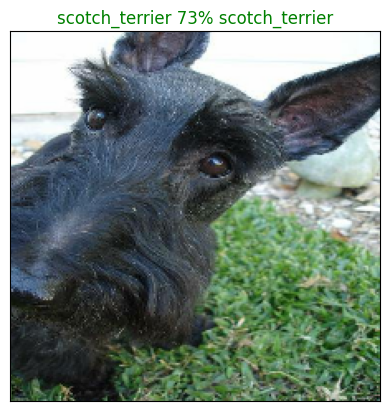

In [70]:
plot_pred(prediction_probabilities=predictions, labels=val_labels, images=val_images, n=1);

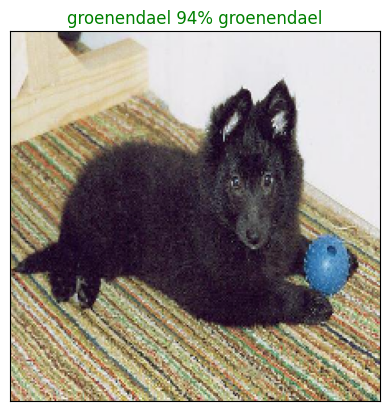

In [71]:
plot_pred(prediction_probabilities=predictions, labels=val_labels, images=val_images, n=77);

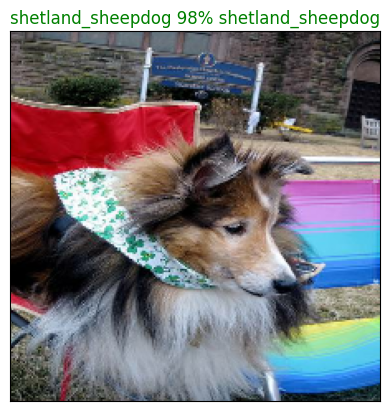

In [72]:
plot_pred(prediction_probabilities=predictions, labels=val_labels, images=val_images, n=57);

Now we've got one function to visualize our models top prediction, let's make another to view our models top 10 predictions.

This function will:
- Take an input of prediction probabilities array and a ground truth array and an integer. ✅
- Find the prediction to `get_pred_label()` ✅
- Find the top 10:
  - Prediction probabilities indexes
  - Prediciton probabilities values
  - Prediction labels.
- Plot the top 10 prediction probability values and labels, coloring the true label green.

In [73]:
def plot_pred_conf(prediction_probabilities, labels, n=1):
  """
  Plus the top 10 highest prediction confidences along with the truth label for sample n.
  """

  pred_prob, true_label = prediction_probabilities[n], labels[n]

  # Get the predicted label
  pred_label = get_pred_label(pred_prob)

  # Find the top 10 prediction confidence indexes
  top_10_pred_indexes = pred_prob.argsort()[-10:][::-1]
  # Find the top 10 prediction confidence values
  top_10_pred_values = pred_prob[top_10_pred_indexes]
  # Find the top 10 prediction labels:
  top_10_pred_labels = unique_breeds[top_10_pred_indexes]

  # Setup plot
  top_plot = plt.bar(np.arange(len(top_10_pred_labels)),
                               top_10_pred_values,
                               color='red')
  plt.xticks(np.arange(len(top_10_pred_labels)), labels=top_10_pred_labels, rotation='vertical')

  # Change color of true label.
  if np.isin(true_label, top_10_pred_labels):
    top_plot[np.argmax(top_10_pred_labels == true_label)].set_color('green')
  else:
    pass

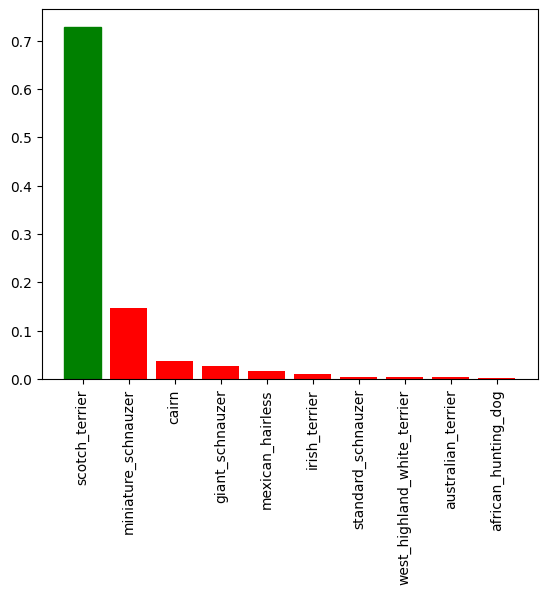

In [74]:
plot_pred_conf(prediction_probabilities=predictions, labels=val_labels, n=1);

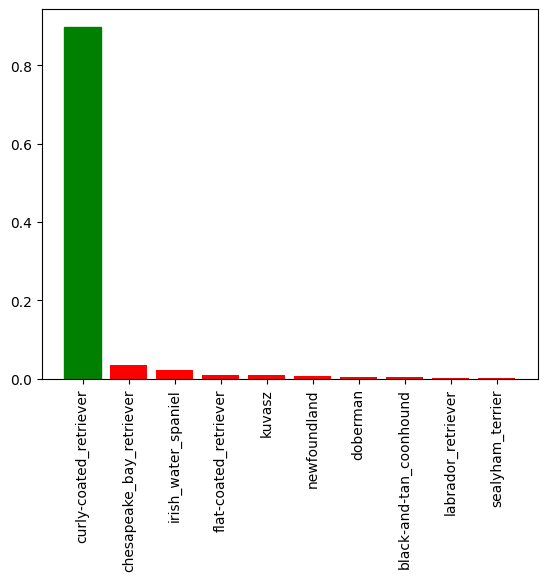

In [75]:
plot_pred_conf(prediction_probabilities=predictions, labels=val_labels, n=76);

Now we've got some functions to help us visualize our predictions and evaluate our model, let's check out a few.

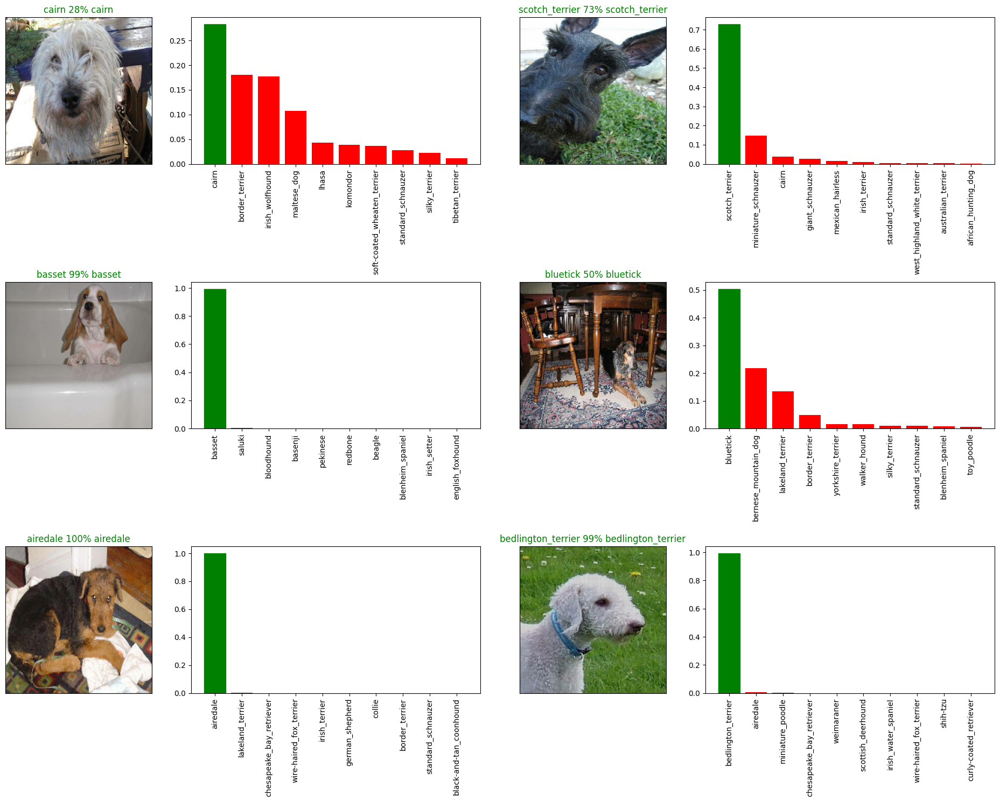

In [76]:
# Let's check out a few predictions and their different values.

i_multiplier = 0
num_rows = 3
num_cols = 2
num_images = num_rows * num_cols
plt.figure(figsize=(10*num_cols, 5*num_rows))

for i in range (num_images):
  plt.subplot(num_rows, 2*num_cols, 2*i+1)
  plot_pred(prediction_probabilities=predictions, labels=val_labels, images=val_images, n=i+i_multiplier)
  plt.subplot(num_rows, 2*num_cols, 2*i+2)
  plt.tight_layout()
  plot_pred_conf(prediction_probabilities=predictions, labels=val_labels, n=i+i_multiplier)

plt.tight_layout(h_pad=1.0)

plt.show()

**Challenge:** How would you create a confusion matrix with our models predictions and true labels?

## Saving and reloading a trained model

In [77]:
# Create a function to save a model

def save_model(model, suffix=""):
    """
    Saves a given model to a directory with a timestamp and optional suffix in the SavedModel format.
    """
    # Create a directory path for saving models
    model_dir = os.path.join("drive/My Drive/Colab Notebooks/Models",
                             datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))

    # Add suffix to model directory if provided
    if suffix:
        model_dir += f"-{suffix}"

    # Create the directory if it doesn't exist
    os.makedirs(model_dir, exist_ok=True)

    # Save the model in SavedModel format
    print(f"Saving model to: {model_dir}...")
    model.save(model_dir, save_format='tf')  # Save the model in SavedModel format
    return model_dir

In [78]:
# Create a function to load a model!

def load_model(model_path):
    """
    Loads a saved model from a specified path.
    """
    if not os.path.exists(model_path):
        raise FileNotFoundError(f"Model file not found at: {model_path}")

    print(f"Loading saved model from: {model_path}")
    model = tf.keras.models.load_model(model_path)
    return model

Now we've got functions to save and load a trained model, let's make sure they work!!!

In [79]:
# Save our model trained on 1000 images.

save_model(model, suffix="1000-images-mobilenetv2-Adam")

Saving model to: drive/My Drive/Colab Notebooks/Models/20250116-034055-1000-images-mobilenetv2-Adam...


'drive/My Drive/Colab Notebooks/Models/20250116-034055-1000-images-mobilenetv2-Adam'

In [80]:
# Load a trained model
loaded_1000_image_model = tf.keras.models.load_model("drive/My Drive/Colab Notebooks/Models/20250112-233950-1000-images-mobilenetv2-Adam")

In [81]:
# Evaluate the pre-saved model.

model.evaluate(val_data)

7/7 [==============================] - 1s 164ms/step - loss: 1.1710 - accuracy: 0.7000


[1.1710467338562012, 0.699999988079071]

In [82]:
# Evaluate the loaded model

loaded_1000_image_model.evaluate(val_data)

7/7 [==============================] - 2s 143ms/step - loss: 5.5745 - accuracy: 0.0000e+00


[5.574505805969238, 0.0]

# Training a big dawg 🐶 model (on the full data)

In [83]:
len(X), len(y)

(10222, 10222)

In [84]:
X[:10], y[:10]

(['drive/My Drive/Colab Notebooks/train/000bec180eb18c7604dcecc8fe0dba07.jpg',
  'drive/My Drive/Colab Notebooks/train/001513dfcb2ffafc82cccf4d8bbaba97.jpg',
  'drive/My Drive/Colab Notebooks/train/001cdf01b096e06d78e9e5112d419397.jpg',
  'drive/My Drive/Colab Notebooks/train/00214f311d5d2247d5dfe4fe24b2303d.jpg',
  'drive/My Drive/Colab Notebooks/train/0021f9ceb3235effd7fcde7f7538ed62.jpg',
  'drive/My Drive/Colab Notebooks/train/002211c81b498ef88e1b40b9abf84e1d.jpg',
  'drive/My Drive/Colab Notebooks/train/00290d3e1fdd27226ba27a8ce248ce85.jpg',
  'drive/My Drive/Colab Notebooks/train/002a283a315af96eaea0e28e7163b21b.jpg',
  'drive/My Drive/Colab Notebooks/train/003df8b8a8b05244b1d920bb6cf451f9.jpg',
  'drive/My Drive/Colab Notebooks/train/0042188c895a2f14ef64a918ed9c7b64.jpg'],
 [array([False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False,  True, False, False, False, False, False, False, 

In [85]:
# Create a data batch with the full data set.

full_data = create_data_batches(X, y)

Creating training data batches...


In [86]:
full_data

<_BatchDataset element_spec=(TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None, 120), dtype=tf.bool, name=None))>

In [87]:
full_model = create_model()

Building model with: https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/4


In [88]:
# Create full model callbacks
full_model_tensorboard = create_tensorboard_callback()

# No validation set when training on all the data, so we can't monitor validation accuracy.
full_model_early_stopping = tf.keras.callbacks.EarlyStopping(monitor="accuracy",
                                                             patience=3)

**Note:** Running the cell below will take a while. Maybe up to 30-45 minutes - because the GPU we're using in the runtime has to load all of the images into memory.

In [89]:
# Fit the entire model to the full data
full_model.fit(x=full_data, epochs=NUM_EPOCHS, callbacks=[full_model_tensorboard, full_model_early_stopping])

Layer ModuleWrapper was created by passing
non-serializable argument values in `__init__()`,
and therefore the layer must override `get_config()` in
order to be serializable. Please implement `get_config()`.

Example:

class CustomLayer(keras.layers.Layer):
    def __init__(self, arg1, arg2, **kwargs):
        super().__init__(**kwargs)
        self.arg1 = arg1
        self.arg2 = arg2

    def get_config(self):
        config = super().get_config()
        config.update({
            "arg1": self.arg1,
            "arg2": self.arg2,
        })
        return config


Epoch 1/100
320/320 [==============================] - 51s 147ms/step - loss: 1.3715 - accuracy: 0.6681
Epoch 2/100
320/320 [==============================] - 45s 141ms/step - loss: 0.4068 - accuracy: 0.8806
Epoch 3/100
320/320 [==============================] - 44s 136ms/step - loss: 0.2425 - accuracy: 0.9330
Epoch 4/100
320/320 [==============================] - 48s 148ms/step - loss: 0.1545 - accuracy: 0.9636
Epoch 5/100
320/320 [==============================] - 44s 139ms/step - loss: 0.1083 - accuracy: 0.9783
Epoch 6/100
320/320 [==============================] - 43s 134ms/step - loss: 0.0782 - accuracy: 0.9870
Epoch 7/100
320/320 [==============================] - 43s 136ms/step - loss: 0.0599 - accuracy: 0.9911
Epoch 8/100
320/320 [==============================] - 42s 131ms/step - loss: 0.0473 - accuracy: 0.9942
Epoch 9/100
320/320 [==============================] - 41s 128ms/step - loss: 0.0372 - accuracy: 0.9958
Epoch 10/100
320/320 [==============================] - 41s 127m

In [93]:
save_model(full_model, suffix="full-model")

Saving model to: drive/My Drive/Colab Notebooks/Models/20250116-040717-full-model...


'drive/My Drive/Colab Notebooks/Models/20250116-040717-full-model'

## Making Predictions on the test dataset

Since our model has been trained on images in the form of Tensor batches, to make predictions on the test data, we'll have to get it into the same format.

Luckily we created `create_data_batches()` earlier which can take a list of filenames as input and conver them into Tensor batches.

To make predictions on the test data, we'll:
- Get the test image filenames
- Convert the filenames into test data batches using `create_data_batches()` and setting the `test_data` parameters to `True` (since the test data doesn't have labels).
- Make predictions array by passing the test data batches to the `predict()` method called on our model.

In [115]:
# Load test image filenames

test_path = "drive/My Drive/Colab Notebooks/test/"
test_filenames = [test_path + fname for fname in os.listdir(test_path)]
test_filenames = [filename for filename in test_filenames if filename.lower().endswith(('.jpg', '.jpeg', '.png'))]
test_filenames[:10]

['drive/My Drive/Colab Notebooks/test/dd7867245d5c104fffb5afe027e41cd1.jpg',
 'drive/My Drive/Colab Notebooks/test/e34654831e228ad3ac1d0c463e70caf6.jpg',
 'drive/My Drive/Colab Notebooks/test/e440ec011c3c7ea94838ab5fc466159c.jpg',
 'drive/My Drive/Colab Notebooks/test/e5657f523cf994628f63b673c88e9112.jpg',
 'drive/My Drive/Colab Notebooks/test/e2166bdff9e35f80aa7984ec64c8cce8.jpg',
 'drive/My Drive/Colab Notebooks/test/e57a2bee790b512b2ba824b26f3f93fd.jpg',
 'drive/My Drive/Colab Notebooks/test/dcab2d03a686ab3f31d1bc3e5700f6d1.jpg',
 'drive/My Drive/Colab Notebooks/test/de084b830010b6107215fef5d4a75b94.jpg',
 'drive/My Drive/Colab Notebooks/test/e715a411098c046cac90c3facfa58c77.jpg',
 'drive/My Drive/Colab Notebooks/test/e4413cd1ee44a05cc7991ae0d097b062.jpg']

In [116]:
len(test_filenames)

10357

In [117]:
# Create test data batch

test_data = create_data_batches(test_filenames, test_data=True)

Creating test data batches...


In [118]:
test_data

<_BatchDataset element_spec=TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None)>

In [108]:
loaded_full_model = load_model("drive/My Drive/Colab Notebooks/Models/20250116-040717-full-model")

Loading saved model from: drive/My Drive/Colab Notebooks/Models/20250116-040717-full-model


**Note:** Calling `predict()` on our full model and passing it the test data batch will take a long time to run. (about an hour)

In [119]:
# Make predictions on test data batch using the loaded full model.

test_predictions = loaded_full_model.predict(test_data, verbose=1)

324/324 [==============================] - 460s 1s/step


In [126]:
test_predictions

array([[1.6490408e-10, 2.6947039e-10, 7.9000334e-10, ..., 1.0987080e-09,
        1.6266449e-07, 6.0858536e-09],
       [1.8976948e-10, 3.6238850e-12, 5.6782573e-10, ..., 4.8617558e-06,
        2.1815241e-09, 8.4474527e-10],
       [3.3306188e-07, 1.9589455e-10, 5.1458338e-12, ..., 6.1467925e-10,
        2.1023544e-07, 4.3376122e-07],
       ...,
       [6.9230299e-10, 2.4473124e-09, 5.4537280e-10, ..., 6.9613137e-09,
        5.0118660e-09, 2.3695813e-11],
       [9.2588516e-04, 7.1262799e-02, 4.0243114e-07, ..., 5.1181807e-05,
        6.0653633e-06, 3.8403505e-07],
       [1.2008843e-07, 4.7980092e-04, 1.8414788e-08, ..., 6.8994901e-05,
        1.5760506e-07, 2.6213359e-06]], dtype=float32)

In [165]:
# Turn prediction probas into their respective label (easier to understand!)

def get_pred_label(prediction_probabilities):
  """
  Turns an array of prediction probabilities into a label.
  """
  return unique_breeds[np.argmax(prediction_probabilities)]

# Get a predicted label based on an array of prediction probabilities

In [168]:
test_pred_labels = [get_pred_label(test_predictions[i]) for i in range(len(test_predictions))]

test_images = []
for image in test_data.unbatch().as_numpy_iterator():  # Unbatch and iterate
    test_images.append(image)

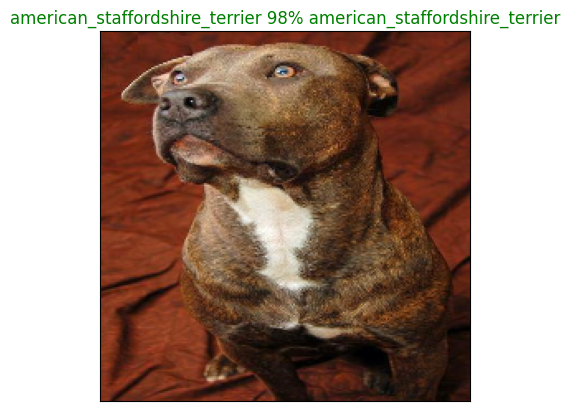

In [170]:
plot_pred(prediction_probabilities=test_predictions, labels=test_pred_labels, images=test_images, n=1)

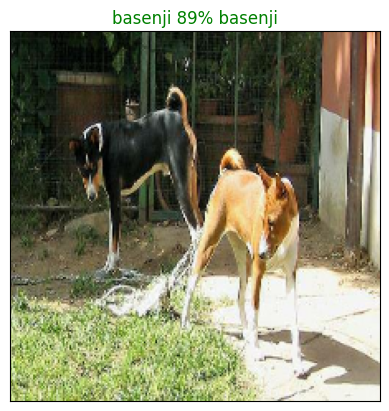

In [171]:
plot_pred(prediction_probabilities=test_predictions, labels=test_pred_labels, images=test_images, n=77)

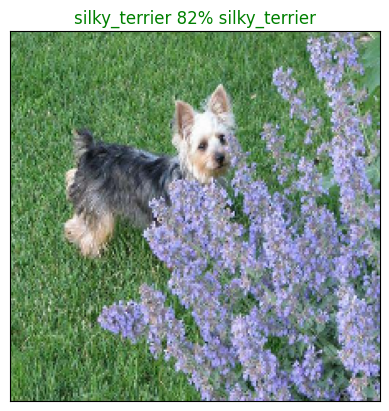

In [172]:
plot_pred(prediction_probabilities=test_predictions, labels=test_pred_labels, images=test_images, n=45)

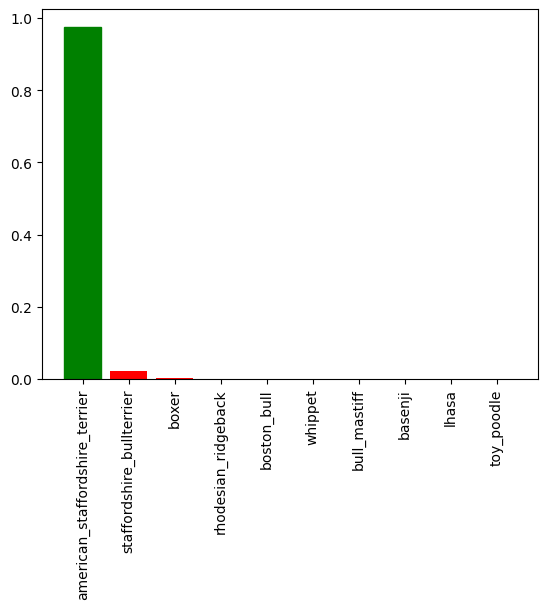

In [173]:
plot_pred_conf(prediction_probabilities=test_predictions, labels=test_pred_labels, n=1)

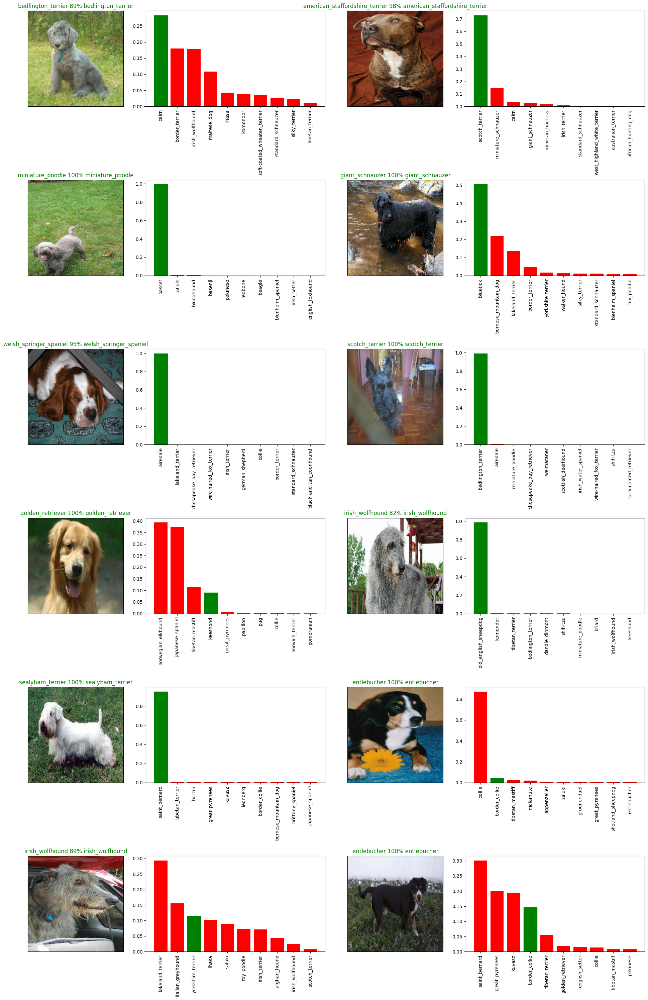

In [176]:
# Let's check out a few predictions and their different values.

i_multiplier = 0
num_rows = 6
num_cols = 2
num_images = num_rows * num_cols
plt.figure(figsize=(10*num_cols, 5*num_rows))

for i in range (num_images):
  plt.subplot(num_rows, 2*num_cols, 2*i+1)
  plot_pred(prediction_probabilities=test_predictions, labels=test_pred_labels, images=test_images, n=i+i_multiplier)
  plt.subplot(num_rows, 2*num_cols, 2*i+2)
  plt.tight_layout()
  plot_pred_conf(prediction_probabilities=predictions, labels=val_labels, n=i+i_multiplier)

plt.tight_layout(h_pad=1.0)

plt.show()

#  Making Predictions on Custom Images:

To make predictions on custom images, we'll:
- Get the filepaths of our own images.
- Turn the filepaths into data batches using `create_data_batches()`. And since our custom images won't have labels, we set the `test_data` parameter to `True`.
- Pass the custom image data batch to our model's `predict()` method.
- Convert the prediction output probabilities to prediction labels.
- Compare the predicted labels to the custom images.

In [209]:
# Get custom image filepaths.
custom_path = "drive/My Drive/Colab Notebooks/my-dog-photos/"
custom_image_paths = [custom_path + fname for fname in os.listdir(custom_path) if fname.lower().endswith(('.jpg', '.webp', '.png', '.jpeg'))]
custom_image_paths

['drive/My Drive/Colab Notebooks/my-dog-photos/big-dog-breeds.jpeg',
 'drive/My Drive/Colab Notebooks/my-dog-photos/bullmastiff.jpg',
 'drive/My Drive/Colab Notebooks/my-dog-photos/small-dog-owners-1.jpg',
 'drive/My Drive/Colab Notebooks/my-dog-photos/AG_Cody.jpg']

In [210]:
# Turn custom images into batch datasets

custom_data = create_data_batches(custom_image_paths, test_data=True)
custom_data

Creating test data batches...


<_BatchDataset element_spec=TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None)>

In [211]:
# Make predictions on the custom data.
custom_preds = full_model.predict(custom_data)

1/1 [==============================] - 2s 2s/step


In [212]:
custom_preds, custom_preds.shape

(array([[3.88166971e-10, 8.90608831e-09, 1.28227942e-10, 5.22566211e-07,
         4.74390376e-08, 8.35679828e-07, 4.73198813e-10, 3.22986027e-10,
         7.57747587e-10, 6.65857369e-11, 1.08916502e-08, 4.79847770e-08,
         2.40176305e-04, 7.52545855e-12, 9.55145765e-07, 2.94910389e-08,
         1.53498470e-12, 1.64224856e-10, 3.30316698e-12, 8.68549399e-11,
         6.05253569e-10, 6.49838583e-08, 7.73387354e-10, 1.01175422e-10,
         6.60680607e-11, 2.86731368e-08, 1.20647051e-11, 1.97867262e-13,
         4.50217605e-08, 4.88694812e-14, 4.26775459e-09, 1.42290035e-09,
         2.16110596e-09, 8.50721923e-12, 3.93147320e-06, 2.55461674e-09,
         6.44619358e-11, 9.90030002e-11, 9.25190281e-04, 7.71974984e-11,
         3.76328385e-10, 8.27833548e-12, 4.14337876e-07, 1.66558034e-09,
         4.83495466e-10, 5.41190381e-08, 1.29805122e-09, 1.75385206e-10,
         6.97606674e-06, 4.29593827e-09, 3.47571904e-06, 1.37026568e-08,
         9.13170410e-08, 3.44448335e-06, 2.73519193

In [213]:
# Get custom image prediction labels
custom_pred_labels = [get_pred_label(custom_preds[i]) for i in range(len(custom_preds))]
custom_pred_labels

['rottweiler', 'bull_mastiff', 'yorkshire_terrier', 'toy_poodle']

In [214]:
# Get custom images (our unbatchify() function won't work since there aren't labels... maybe we could fix this later?)

custom_images = []

# Loop through unbatched data
for image in custom_data.unbatch().as_numpy_iterator():
  custom_images.append(image)

In [215]:
len(custom_images)

4

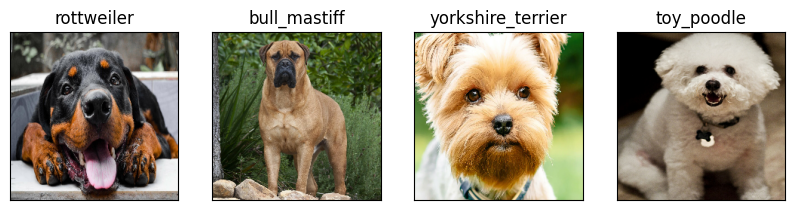

In [218]:
# Check custom image predictions

plt.figure(figsize=(10,10))

for i, image in enumerate(custom_images):
  plt.subplot(1, len(custom_images), i+1)
  plt.xticks([])
  plt.yticks([])
  plt.title(custom_pred_labels[i])
  plt.imshow(image)

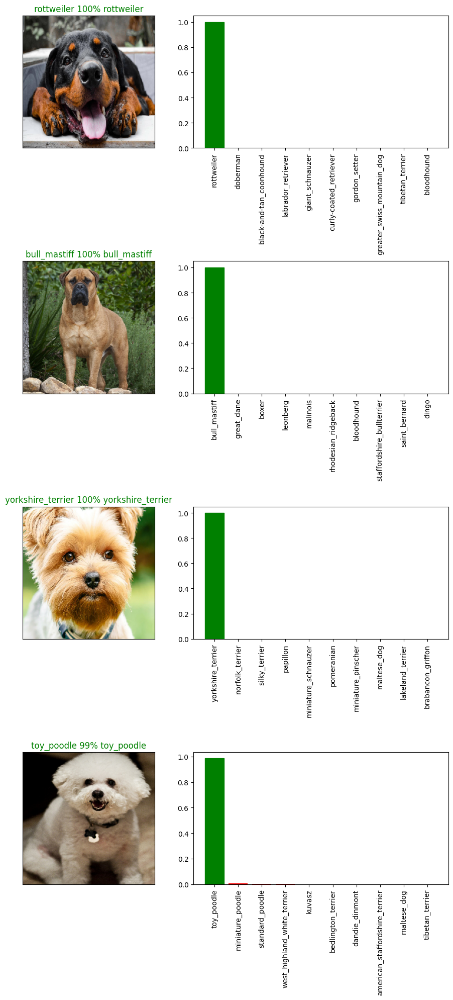

In [220]:
# Let's check out a few predictions and their different values.

i_multiplier = 0
num_rows = (len(custom_images) )
num_cols = 1
num_images = num_rows * num_cols
plt.figure(figsize=(10*num_cols, 5*num_rows))

for i in range (num_images):
  plt.subplot(num_rows, 2*num_cols, 2*i+1)
  plot_pred(prediction_probabilities=custom_preds, labels=custom_pred_labels, images=custom_images, n=i+i_multiplier)
  plt.subplot(num_rows, 2*num_cols, 2*i+2)
  plt.tight_layout()
  plot_pred_conf(prediction_probabilities=custom_preds, labels=custom_pred_labels, n=i+i_multiplier)

plt.tight_layout(h_pad=1.0)

plt.show()

No way I built an actual dog guesser